## Análise de Dados para o Desafio do Vinho

Autor : Natanael Junior (natmourajr@gmail.com)

### Objetivo do notebook

Criar uma análise exploratória para avaliar a consistência dos dados e identificar possíveis variáveis que impactam na qualidade do vinho.

### Fazer a carga das bibliotecas

In [2]:
%time
import os
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline

CPU times: user 31 µs, sys: 11 µs, total: 42 µs
Wall time: 302 µs


### Carga de dados do arquivo

In [4]:
%time
df = pd.read_csv('data/winequality.csv', sep=';')
df.head(10)

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 4.77 µs


,type,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,White,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,White,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,White,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,White,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,White,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
5,White,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
6,White,6.2,0.32,0.16,7.0,0.045,30.0,136.0,0.9949,3.18,0.47,9.6,6
7,White,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
8,White,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
9,White,8.1,0.22,0.43,1.5,0.044,28.0,129.0,0.9938,3.22,0.45,11,6


Por alguma razão, o teor de alcoólico possui amostras com strings muito grandes associadas, por exemplo "128.933.333.333.333". Parece que houve algum erro no processo de aquisição de dados. Possivelmente, eu possa substituir estas amostras através de um processo de inferência estatística. Mas vou continuar a análise removendo as mesmas. Assim sendo, algumas amostras serão corretamente mapeadas como do tipo numérico (inteiro ou float).

In [5]:
print('Porcentagem total de amostras retiradas: %1.3f%%'%(100*df['alcohol'].loc[df['alcohol'].str.len()>10].index.values.shape[0]/
                                                         df['alcohol'].shape[0]))

Porcentagem total de amostras retiradas: 0.616%


In [5]:
df.drop(df['alcohol'].loc[df['alcohol'].str.len()>10].index.values, axis=0, inplace=True)

In [6]:
df['alcohol'] = pd.to_numeric(df['alcohol'])

### Usando a lib pandas_profiling para uma avaliação da qualidade dos dados

In [11]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title='Pandas Profiling Report', html={'style':{'full_width':True}})

In [154]:
#profile

As análises da maior parte das análises das variáveis foi feita explorando o pandas_profiling. Eu deixei para análises mais profundas apenas alguns pontos que vem a seguir.

Olhando as distribuições, podemos ver que nenhuma variável é gaussiana (distribuição normal). Este fato indica que a modelagem deve utilizar modelos que se apoiem em estatística de ordem superior (HOS), como modelos de redes neurais e deep learning. Outro fato que deve ser observado é a cauda das distribuições. De maneira geral, todas parecem ter uma cauda à direita (comportamento exponencial de decaímento a direita). Fato que deve ser detalhamente modelado.

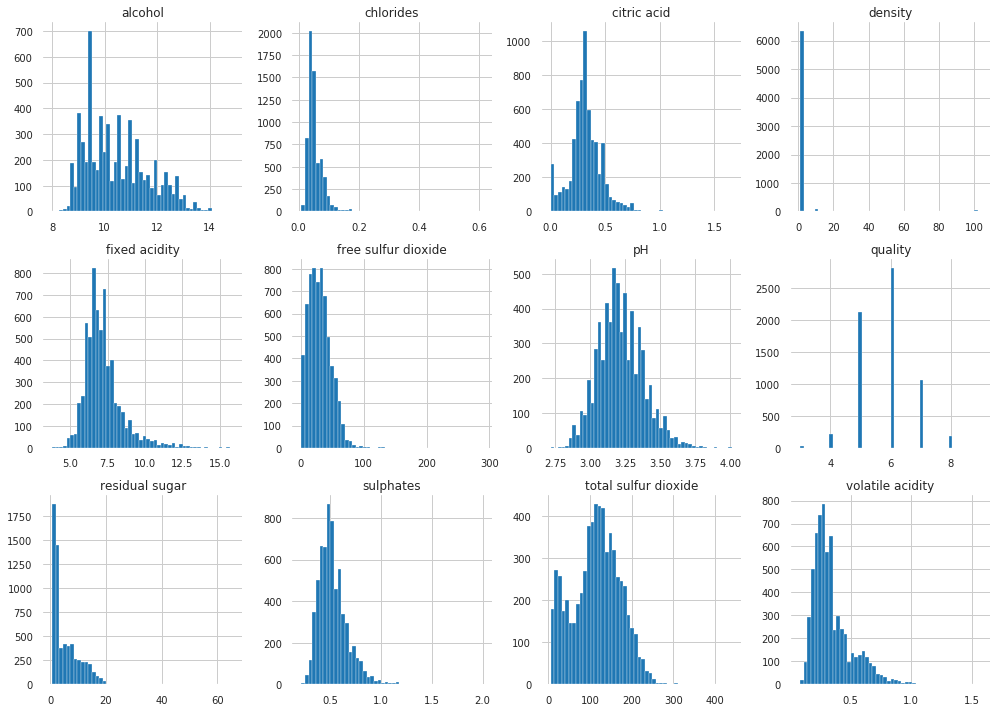

In [155]:
plt.rcParams['figure.figsize']=(14,10)

ax = df.hist(bins=50, layout=[3,4])
plt.tight_layout()

Observando detalhamente a correlação linear entre as variáveis podemos ver que não há nenhuma correlação significativa (em módulo, acima de 80%). Ou seja, não vamos remover nenhuma das 13 variáveis disponíveis para modelagem de dados. Além disso, não há nenhuma correlação linear entre a variável a ser modelada (alvo) e nenhuma das variáveis independentes (variáveis de modelagem), o que indica que um modelo linear não será o suficiente para a modelagem do alvo

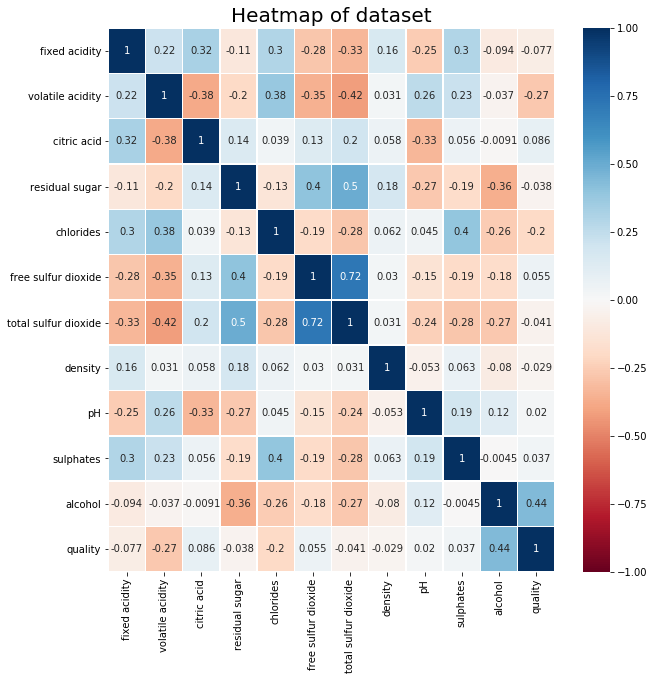

In [8]:
# Correlation heatmap
import seaborn as sns
plt.rcParams['figure.figsize']=(10,10)
fig, ax = plt.subplots()

col_to_corr= ['type', 'fixed acidity', 'volatile acidity', 'citric acid','residual sugar', 
              'chlorides', 'free sulfur dioxide','total sulfur dioxide', 'density', 'pH', 
              'sulphates', 'alcohol','quality']
hm=sns.heatmap(df[col_to_corr].corr(), annot = True, linewidths=.5, cmap='RdBu', vmin=-1, vmax=+1)
hm.set_title(label='Heatmap of dataset', fontsize=20)
hm;

Olhando detalhamente o maior valor da correlação linear, neste caso, vamos olhar as duas variáveis que possuem correlação de 72%.

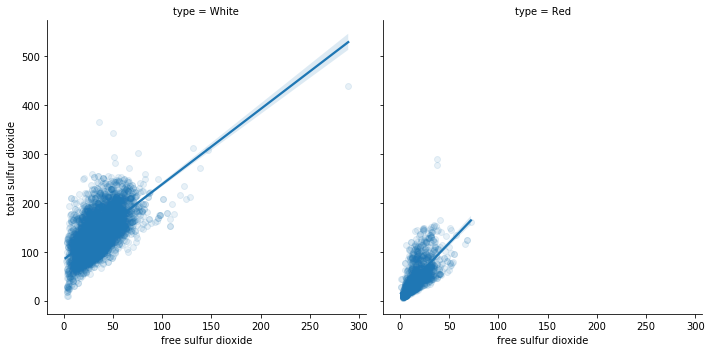

In [9]:
sns.lmplot(x = 'free sulfur dioxide', y = 'total sulfur dioxide', data = df,
          scatter_kws = {'alpha':0.1},
          col = 'type');

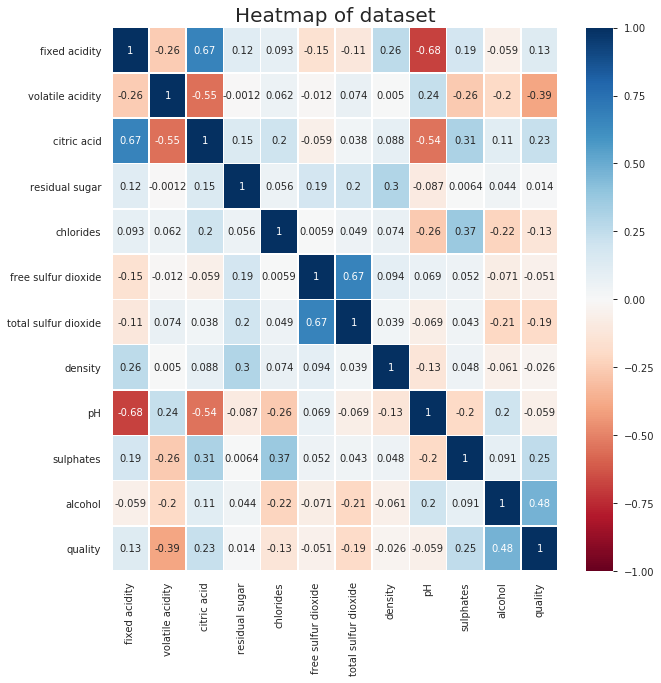

In [157]:
# Correlation heatmap
import seaborn as sns
plt.rcParams['figure.figsize']=(10,10)
fig, ax = plt.subplots()

col_to_corr= ['type', 'fixed acidity', 'volatile acidity', 'citric acid','residual sugar', 
              'chlorides', 'free sulfur dioxide','total sulfur dioxide', 'density', 'pH', 
              'sulphates', 'alcohol','quality']
hm=sns.heatmap(df.loc[df['type']=='Red'][col_to_corr].corr(), annot = True, linewidths=.5, cmap='RdBu', vmin=-1, vmax=+1)
hm.set_title(label='Heatmap of dataset', fontsize=20)
hm;

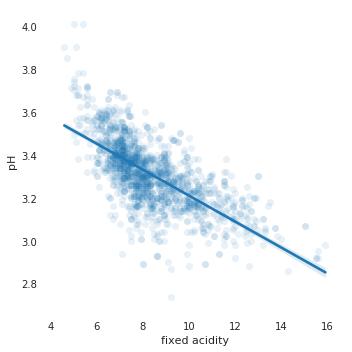

In [164]:
sns.lmplot(x = 'fixed acidity', y = 'pH', 
           data = df.loc[df['type']=='Red'],
           scatter_kws = {'alpha':0.1},);

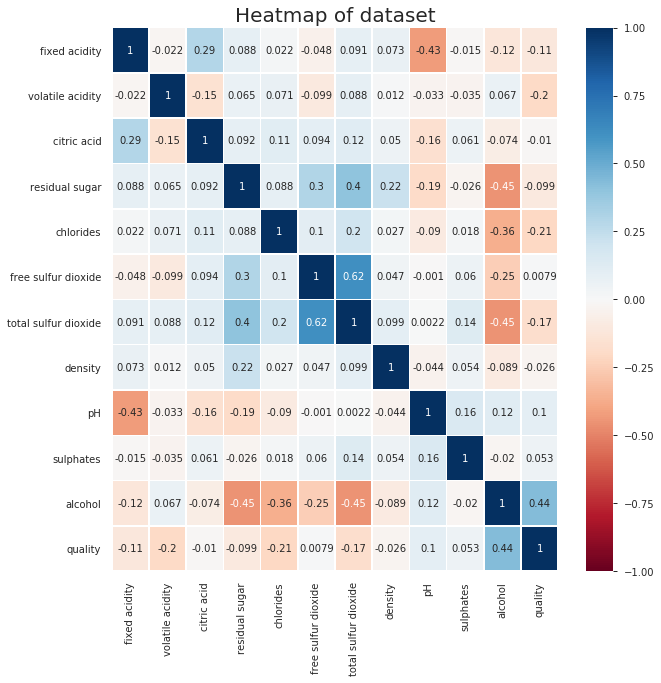

In [158]:
# Correlation heatmap
import seaborn as sns
plt.rcParams['figure.figsize']=(10,10)
fig, ax = plt.subplots()

col_to_corr= ['type', 'fixed acidity', 'volatile acidity', 'citric acid','residual sugar', 
              'chlorides', 'free sulfur dioxide','total sulfur dioxide', 'density', 'pH', 
              'sulphates', 'alcohol','quality']
hm=sns.heatmap(df.loc[df['type']=='White'][col_to_corr].corr(), annot = True, linewidths=.5, cmap='RdBu', vmin=-1, vmax=+1)
hm.set_title(label='Heatmap of dataset', fontsize=20)
hm;

In [7]:
for iclass in np.unique(df['quality']):
    print('Porcentagem de eventos da Qualidade %i = %1.5f'%(iclass,sum(df['quality']==iclass)/df['quality'].shape[0]))

porcentagem de eventos da Qualidade 3 = 0.00465
porcentagem de eventos da Qualidade 4 = 0.03345
porcentagem de eventos da Qualidade 5 = 0.32972
porcentagem de eventos da Qualidade 6 = 0.43596
porcentagem de eventos da Qualidade 7 = 0.16556
porcentagem de eventos da Qualidade 8 = 0.02989
porcentagem de eventos da Qualidade 9 = 0.00077


In [10]:
for iclass in np.unique(df['quality']):
    print('Quantidade de events da Qualidade %i = %1.f'%(iclass,sum(df['quality']==iclass)))

Quantidade de events da Qualidade 3 = 30
Quantidade de events da Qualidade 4 = 216
Quantidade de events da Qualidade 5 = 2129
Quantidade de events da Qualidade 6 = 2815
Quantidade de events da Qualidade 7 = 1069
Quantidade de events da Qualidade 8 = 193
Quantidade de events da Qualidade 9 = 5


Aqui podemos ver que as classes são amplamente desbalanceadas, o que pode comprometer o processo de treinamento